<a href="https://colab.research.google.com/github/Jai14/FYP/blob/main/fyp_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [29]:
import numpy as np
import math
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import os
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
import cv2
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
import torch
from torchvision.transforms.functional import to_pil_image

In [30]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [31]:
# Define the directory path
directory = '/content/drive/MyDrive/data_cloud/train/train_set'

# Function to recursively find image files in subfolders
def find_images(directory):
    image_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            # Check if the file has an image extension
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                image_files.append(os.path.join(root, file))
    return image_files

# Find all image files in subfolders
all_image_paths = find_images(directory)

# Print the paths of all image files found
print("Image files found")
#for image_file in all_image_paths:
#    print(image_file)

Image files found


In [32]:
import torch
from pprint import pprint

# Check if GPU is available
if torch.cuda.is_available():
    # Get the number of available GPUs
    num_gpus = torch.cuda.device_count()

    print(f"Number of available GPUs: {num_gpus}")

    # Print information about each GPU
    for i in range(num_gpus):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")

    # Check if PyTorch is currently using GPU
    current_device = torch.cuda.current_device()
    print(f"\nPyTorch is currently using GPU: {torch.cuda.get_device_name(current_device)}")
else:
    print("No GPU available. PyTorch is using CPU.")

No GPU available. PyTorch is using CPU.


In [37]:
all_image_paths_sorted = sorted(all_image_paths)

In [38]:
pprint(all_image_paths_sorted[0])

'/content/drive/MyDrive/data_cloud/train/train_set/NO/img_100021.jpg'


In [39]:

train_y = [path.split('/')[-2] for path in all_image_paths_sorted]

In [40]:
train_x = all_image_paths_sorted

In [41]:
from sklearn.model_selection import train_test_split
train_x, test_x, train_y, test_y = train_test_split(train_x, train_y, test_size=0.2, random_state=5, stratify=train_y)

In [42]:
count_train = len(train_y)
count_yes_train = train_y.count("YES")
count_no_train = train_y.count("NO")

print("Number of total train :", count_train)
print("Number of 'yes':", count_yes_train)
print("Number of 'no':", count_no_train)

Number of total train : 1440
Number of 'yes': 720
Number of 'no': 720


In [43]:
count_test = len(test_y)
count_yes_train = test_y.count("YES")
count_no_train = test_y.count("NO")

print("Number of total test :", count_test)
print("Number of 'yes':", count_yes_train)
print("Number of 'no':", count_no_train)

Number of total test : 360
Number of 'yes': 180
Number of 'no': 180


In [44]:
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader

In [45]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

In [46]:
transforms = A.Compose(
    [
        A.Resize(height=300, width=300), # Resize to 300x300"
        A.ToFloat(),
        ToTensorV2(),
    ]
)

In [47]:
model_path = '/content/drive/MyDrive/data_cloud/train/my_neural_fyp.pth'

In [48]:
class ImageClassifier(nn.Module):
    def __init__(self, num_classes=2):
        super().__init__()
        self.conv_layer_1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d(3))
        self.conv_layer_2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3))
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=128*33*33, out_features=num_classes))

    def forward(self, x: torch.Tensor):
        x = self.conv_layer_1(x)
        x = self.conv_layer_2(x)
        x = self.classifier(x)
        return x

In [49]:
class image_Dataset(Dataset):
    def __init__(self, image_paths, tensor_encoded_labels, transform=None):
        """
        Args:
            image_paths (list): List of file paths to images.
            labels (list): List of labels corresponding to the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_paths = image_paths
        self.labels = tensor_encoded_labels
        self.transform = transform


    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_filepath = self.image_paths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform is not None and callable(self.transform):
            image = self.transform(image=image)["image"]

        # Convert label to PyTorch tensor
        label = self.labels[idx]

        return image, label

In [50]:
model = ImageClassifier()

In [51]:
model.load_state_dict(torch.load(model_path))

<All keys matched successfully>

In [52]:
model.eval()

# Optionally, move the model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

ImageClassifier(
  (conv_layer_1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_layer_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=139392, out_features=2, bias=True)
  )
)

In [53]:
from sklearn.preprocessing import LabelEncoder

# Initialize the label encoder
label_encoder = LabelEncoder()

# Fit label encoder and transform labels
encoded_labels_test = label_encoder.fit_transform(test_y)
tensor_encoded_labels_test = torch.tensor(encoded_labels_test)
pprint(tensor_encoded_labels_test)

tensor([1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1,
        1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0,
        1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0,
        0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1,
        1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
        0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0,
        0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1,
        1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0,
        0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1,
        1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0,

In [54]:
#######################################################
#                  Create Dataset
#######################################################

test_dataset = image_Dataset(test_x,tensor_encoded_labels_test,transforms)

In [55]:
#######################################################
#                  load Dataset
#######################################################

test_loader = DataLoader(test_dataset, batch_size=2, shuffle=True)

In [56]:
total_correct = 0
total_samples = 0

wrong_predictions = []
right_predictions = []
with torch.no_grad():
    for images, labels in test_loader:
        # Forward pass
        outputs = model(images)

        # Compute predictions
        _, predicted = torch.max(outputs, 1)

        # Collect wrong predictions
        for i in range(len(labels)):
            if predicted[i] != labels[i]:
                wrong_predictions.append((images[i], labels[i], predicted[i]))
            else:
                right_predictions.append((images[i], labels[i], predicted[i]))

        # Update total_correct and total_samples
        total_correct += (predicted == labels).sum().item()
        total_samples += labels.size(0)

# Calculate accuracy
accuracy = 100.0 * total_correct / total_samples
print('Accuracy on the test set: {:.2f}%'.format(accuracy))

Accuracy on the test set: 93.33%


In [57]:
print('No of total samples : {:.2f}'.format(total_samples))
print('No of correct predictions: {:.2f}'.format(total_correct))
print('No of wrong predictions: {:.2f}'.format(total_samples-total_correct))

No of total samples : 360.00
No of correct predictions: 336.00
No of wrong predictions: 24.00


# Analysis of the wrong predictions

****

*   NO = Not safe driving
*   YES = Safe driving



*   {"YES": "Safe", "NO" : "Not safe"}
*   {"YES": "1", "NO" : "0"}


****


In [79]:
label_mapping = {"YES": "Safe", "NO" : "Not safe"}

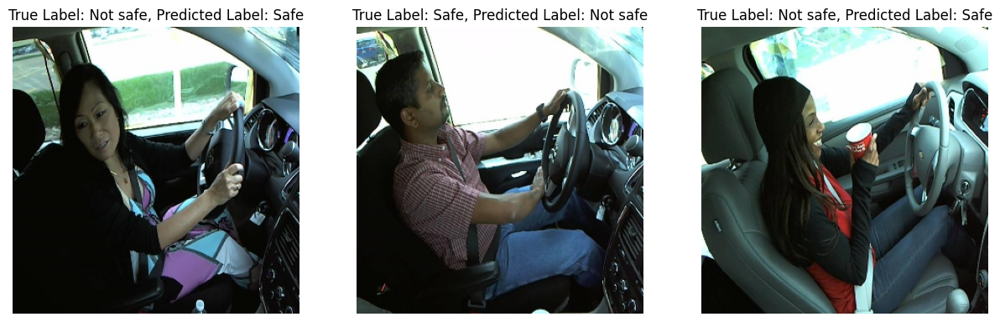

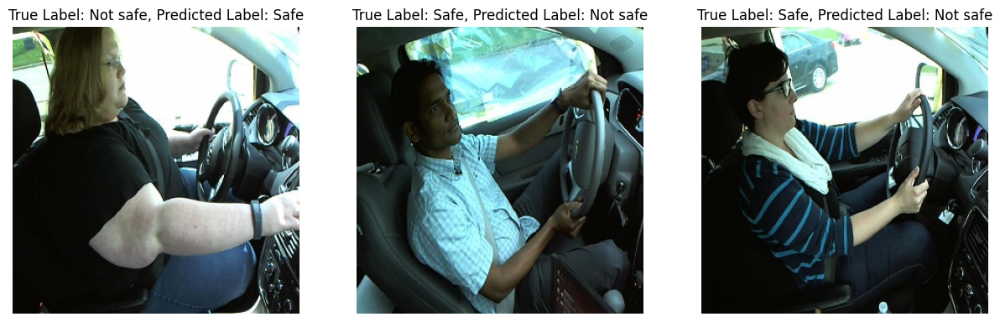

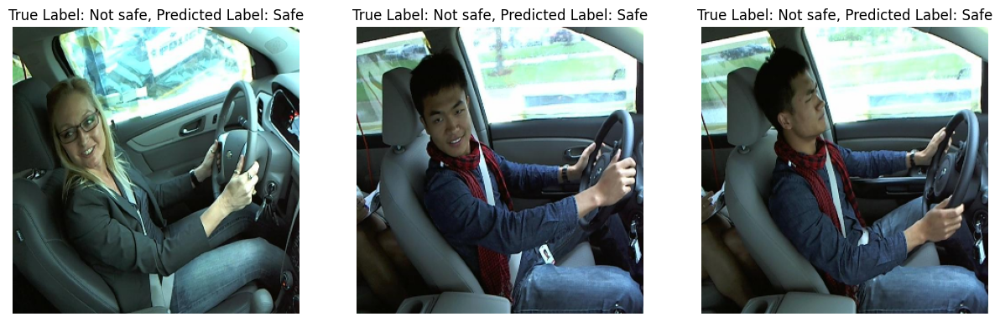

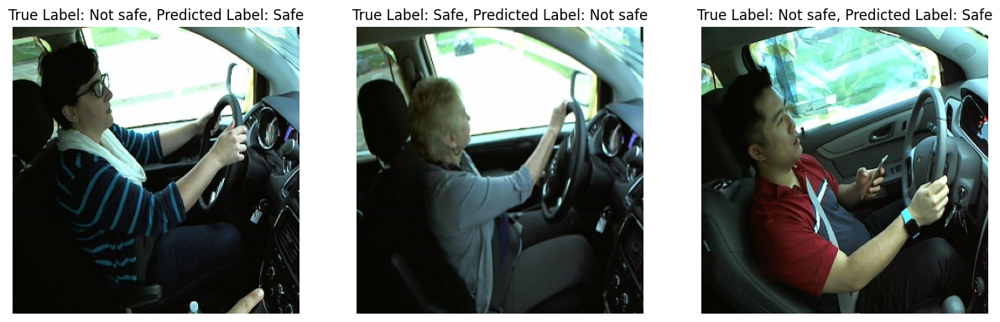

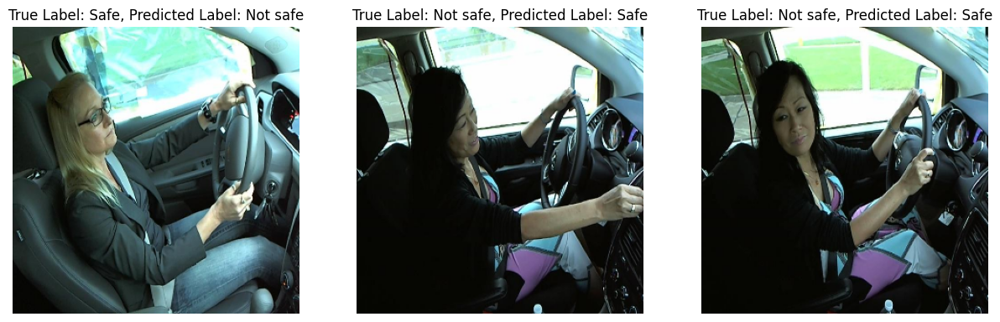

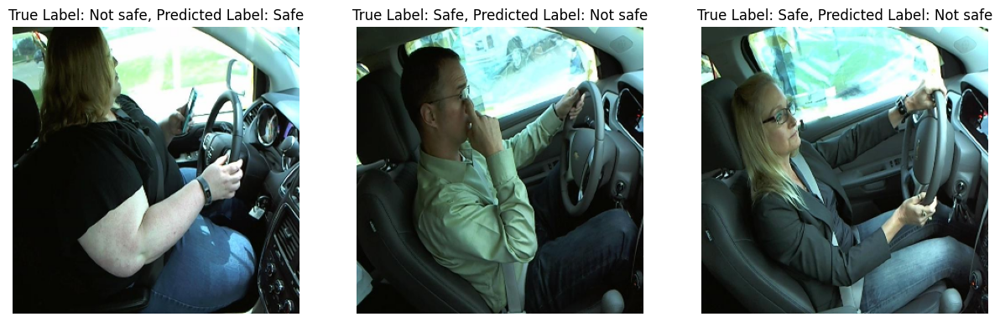

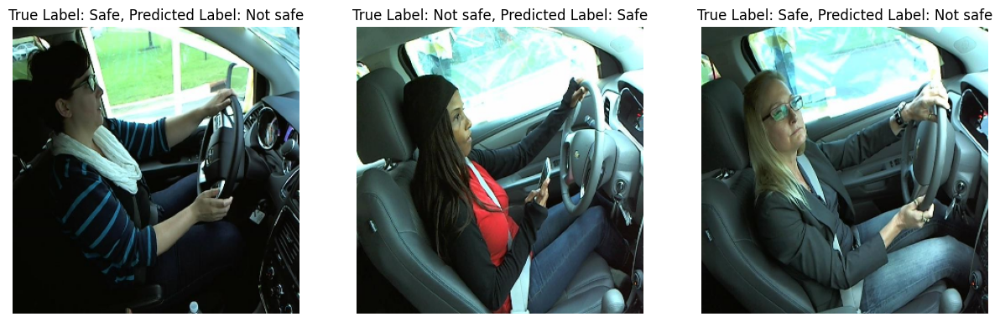

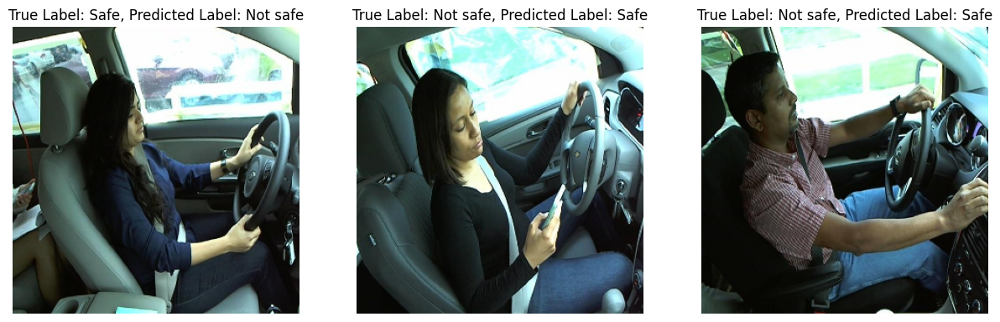

In [166]:
import torchvision.transforms as T
import matplotlib.pyplot as plt

# Define the number of images you want to display in each row
num_images_per_row = 3

# Split wrong_predictions into chunks of size num_images_per_row
chunks = [wrong_predictions[i:i + num_images_per_row] for i in range(0, len(wrong_predictions), num_images_per_row)]

for chunk in chunks:
    # Create a new figure for each row
    plt.figure(figsize=(15, 5))  # Adjust the figure size as needed

    for idx, (image, true_label, predicted_label) in enumerate(chunk):
        encoded_label = int(true_label.item())
        encoded_predicted = int(predicted_label.item())
        values = [encoded_label, encoded_predicted]
        decoded_values = label_encoder.inverse_transform(values)
        encoded_label = decoded_values[0]
        encoded_predicted = decoded_values[1]
        final_label_tag = label_mapping.get(encoded_label)
        final_predicted_tag = label_mapping.get(encoded_predicted)

        transform = T.ToPILImage()
        image = transform(image)

        # Add the subplot
        plt.subplot(1, num_images_per_row, idx + 1)
        plt.imshow(image)
        plt.title(f"True Label: {final_label_tag}, Predicted Label: {final_predicted_tag}")
        plt.axis('off')  # Turn off axis

    plt.show()

In [95]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

true_labels = []
predicted_labels = []

for image, true_label, predicted_label in wrong_predictions:
    encoded_true_label = int(true_label.item())
    encoded_predicted_label = int(predicted_label.item())

    # Decode the labels
    true_label_decoded = label_encoder.inverse_transform([encoded_true_label])[0]
    predicted_label_decoded = label_encoder.inverse_transform([encoded_predicted_label])[0]

    true_labels.append(true_label_decoded)
    predicted_labels.append(predicted_label_decoded)


for image, true_label, predicted_label in right_predictions:
    encoded_true_label = int(true_label.item())
    encoded_predicted_label = int(predicted_label.item())

    # Decode the labels
    true_label_decoded = label_encoder.inverse_transform([encoded_true_label])[0]
    predicted_label_decoded = label_encoder.inverse_transform([encoded_predicted_label])[0]

    true_labels.append(true_label_decoded)
    predicted_labels.append(predicted_label_decoded)

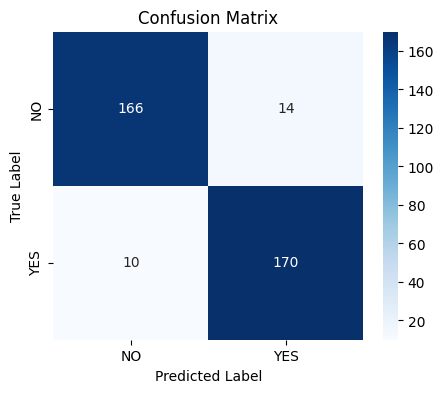

In [96]:
# Compute the confusion matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels, labels=label_encoder.classes_)
# Convert the confusion matrix to a DataFrame for better visualization
conf_matrix_df = pd.DataFrame(conf_matrix, index=label_encoder.classes_, columns=label_encoder.classes_)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(5, 4))
sns.heatmap(conf_matrix_df, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [60]:
pprint(wrong_predictions[1][2])
pprint(right_predictions[1][2])

tensor(0)
tensor(1)


In [26]:
pprint(wrong_predictions[1][0].shape)

torch.Size([3, 300, 300])


In [27]:
my_image = wrong_predictions[1][0].unsqueeze(0)

In [28]:
my_image.shape

torch.Size([1, 3, 300, 300])

# Activation Map

In [82]:
import torch
from torch.utils.hooks import RemovableHandle

In [101]:
pip install grad-cam

ERROR: Could not find a version that satisfies the requirement gradcam (from versions: none)
ERROR: No matching distribution found for gradcam


In [111]:
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import PIL

In [106]:
# use the pretrained ResNet50 model
model.eval()

# fix the target layer (after which we'd like to generate the CAM)
target_layers = [model.conv_layer_2]

In [104]:
pprint(target_layers)

[Sequential(
  (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU()
  (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
)]


# Wrong predictions Activation MAP

## **Yes(Safe) but actually No (Not Safe) (wrongly predicted)**

In [190]:
yes_wrong_predicted_images = [tup[0] for tup in wrong_predictions if tup[1] == torch.tensor(1)]

In [191]:
targets = [ClassifierOutputTarget(torch.tensor(1))]

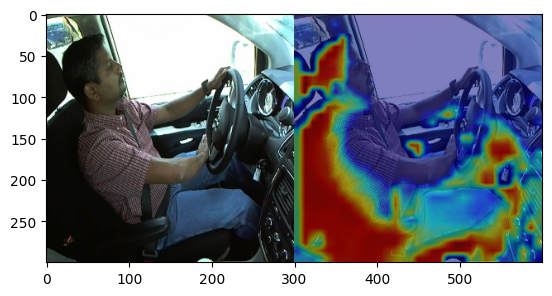

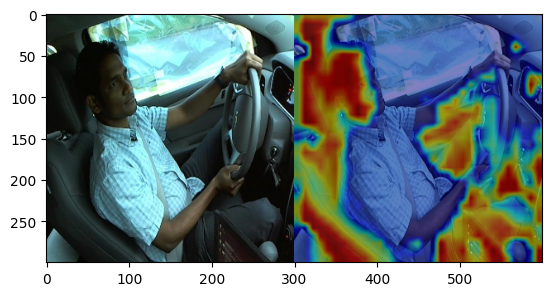

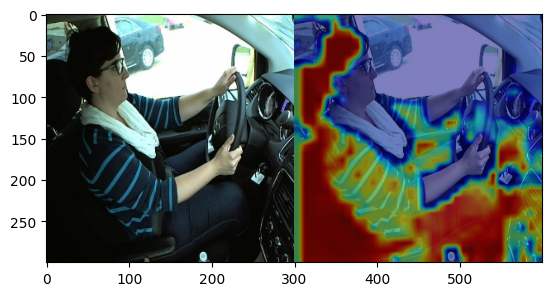

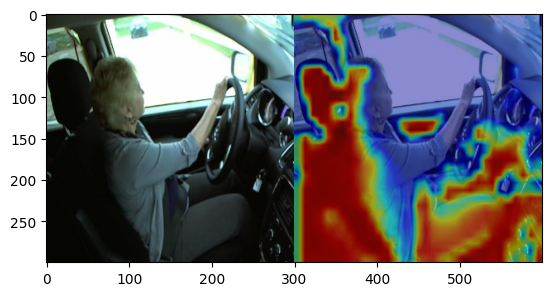

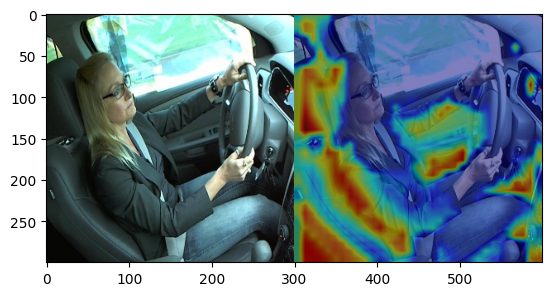

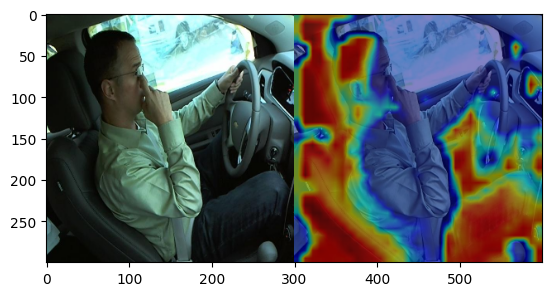

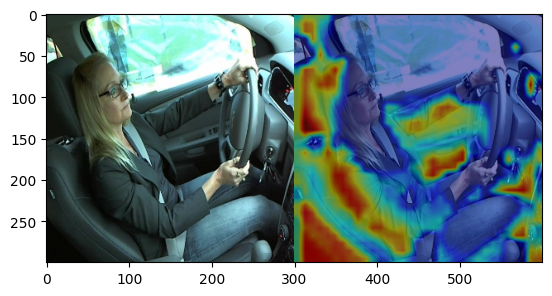

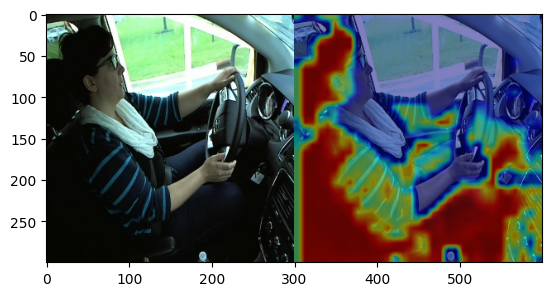

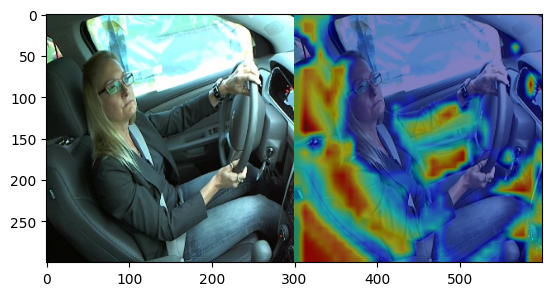

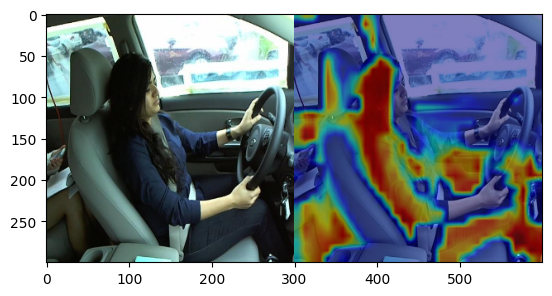

In [192]:
# Instantiate the GradCAM object
cam = GradCAM(model=model, target_layers=target_layers)

for tempImg in yes_wrong_predicted_images:
    input_tensor = tempImg.unsqueeze(0)
    input_image = transform(tempImg)
    input_image = np.float32(input_image) / 255.0

    # Generate CAM
    grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
    cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

    cam_np = np.uint8(255 * grayscale_cams[0, :])
    cam_np = cv2.merge([cam_np, cam_np, cam_np])

    # Display the original image & the associated CAM
    images = np.hstack((np.uint8(255 * input_image), cam_image))
    plt.imshow(images)
    plt.show()

## **No(Not Safe) but Yes(Safe) (wrongly predicted)**

In [193]:
targets = [ClassifierOutputTarget(torch.tensor(0))]

In [194]:
no_wrong_predicted_images = [tup[0] for tup in wrong_predictions if tup[1] == torch.tensor(0)]

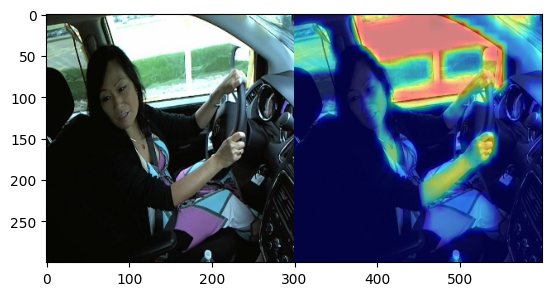

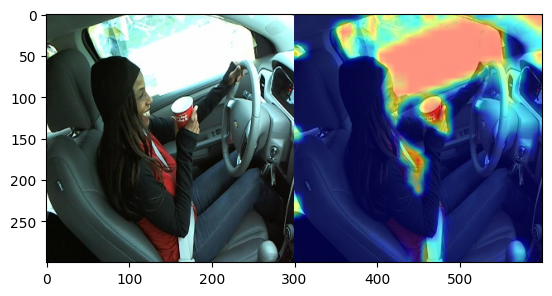

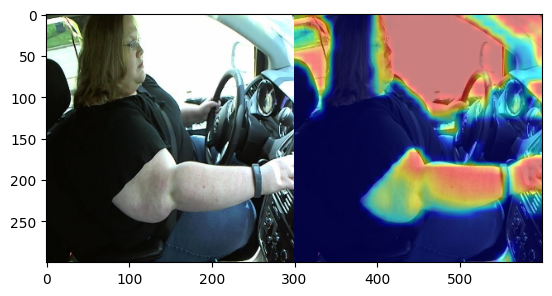

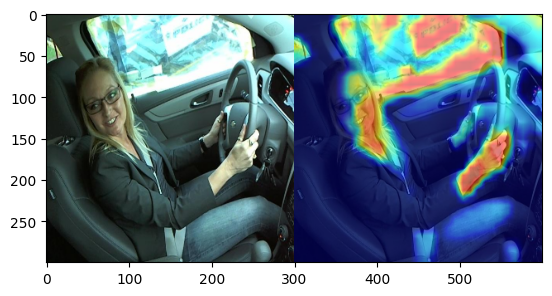

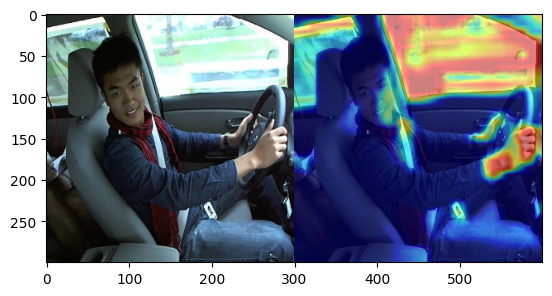

...

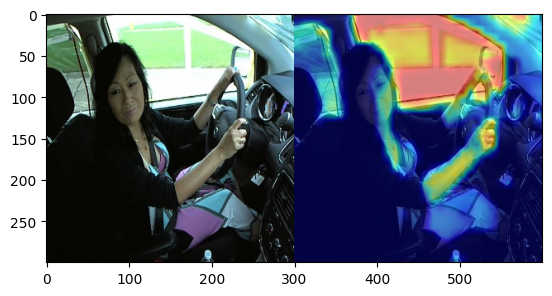

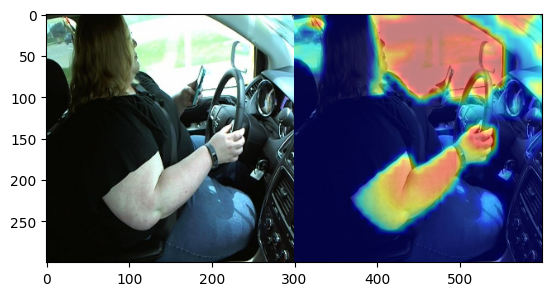

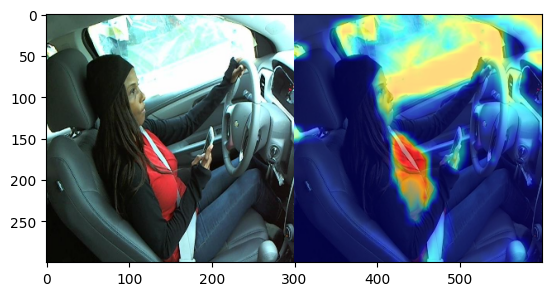

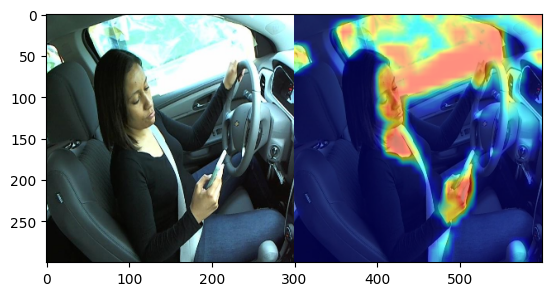

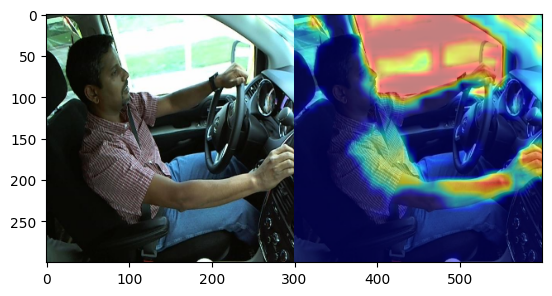

In [195]:
# Instantiate the GradCAM object
cam = GradCAM(model=model, target_layers=target_layers)

for tempImg in no_wrong_predicted_images:
    input_tensor = tempImg.unsqueeze(0)
    input_image = transform(tempImg)
    input_image = np.float32(input_image) / 255.0

    # Generate CAM
    grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
    cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

    cam_np = np.uint8(255 * grayscale_cams[0, :])
    cam_np = cv2.merge([cam_np, cam_np, cam_np])

    # Display the original image & the associated CAM
    images = np.hstack((np.uint8(255 * input_image), cam_image))
    plt.imshow(images)
    plt.show()

# Right predictions Activation MAP

## **Yes(Safe) (Rightly predicted)**

In [203]:
yes_right_predicted_images = [tup[0] for tup in right_predictions if tup[1] == torch.tensor(1)]

In [204]:
targets = [ClassifierOutputTarget(torch.tensor(1))]

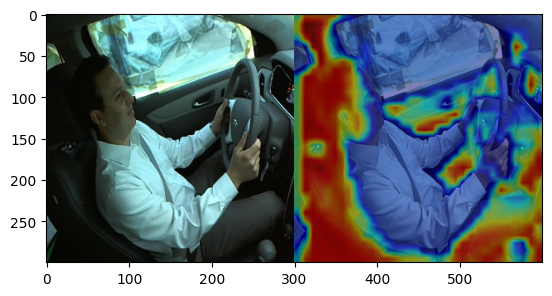

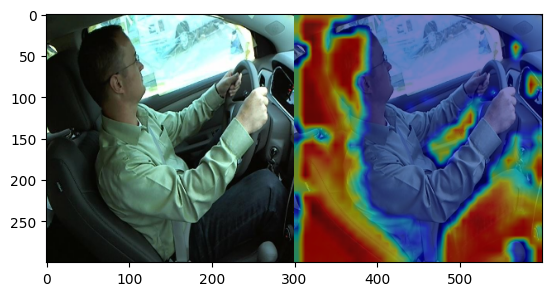

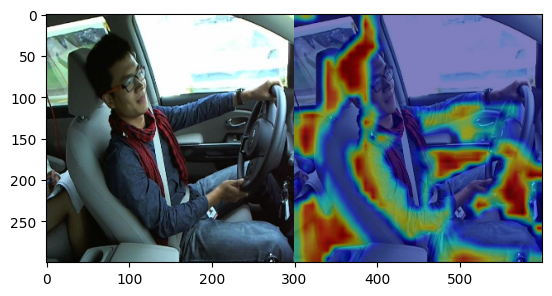

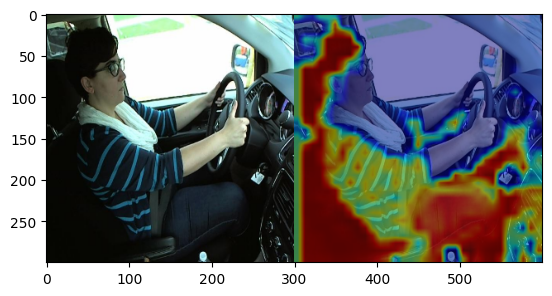

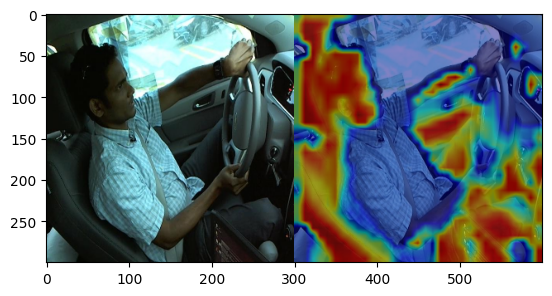

...

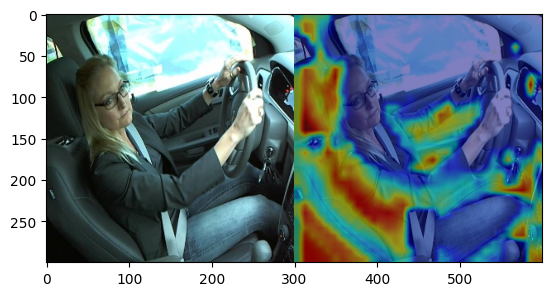

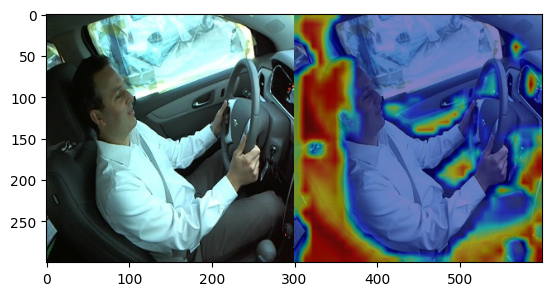

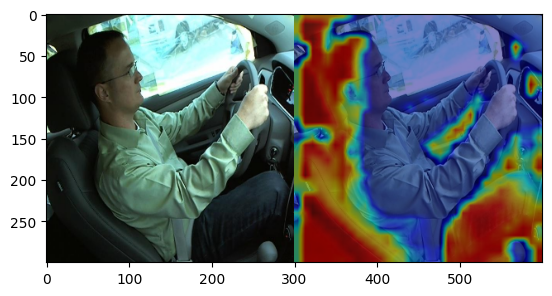

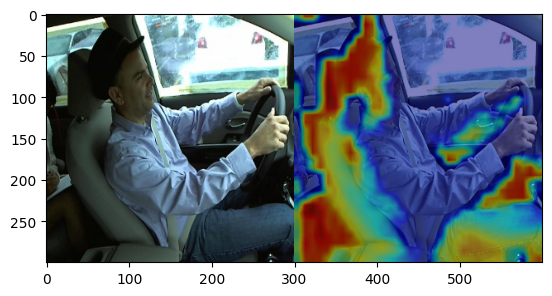

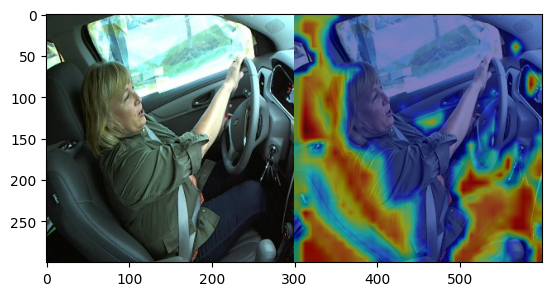

In [205]:
# Instantiate the GradCAM object
cam = GradCAM(model=model, target_layers=target_layers)

for tempImg in yes_right_predicted_images[:30]:
    input_tensor = tempImg.unsqueeze(0)
    input_image = transform(tempImg)
    input_image = np.float32(input_image) / 255.0

    # Generate CAM
    grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
    cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

    cam_np = np.uint8(255 * grayscale_cams[0, :])
    cam_np = cv2.merge([cam_np, cam_np, cam_np])

    # Display the original image & the associated CAM
    images = np.hstack((np.uint8(255 * input_image), cam_image))
    plt.imshow(images)
    plt.show()

## **No(Not Safe) (Rightly predicted)**

In [206]:
targets = [ClassifierOutputTarget(torch.tensor(0))]

In [207]:
no_right_predicted_images = [tup[0] for tup in right_predictions if tup[1] == torch.tensor(0)]

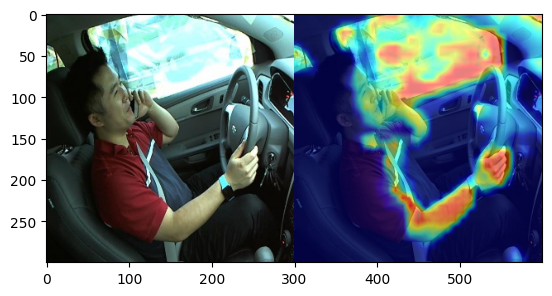

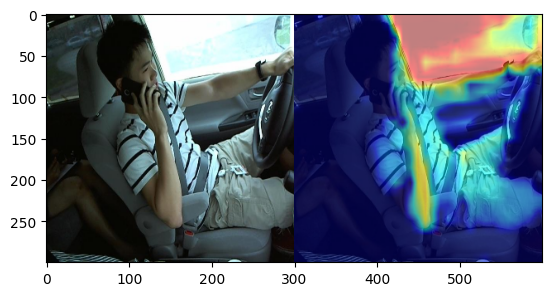

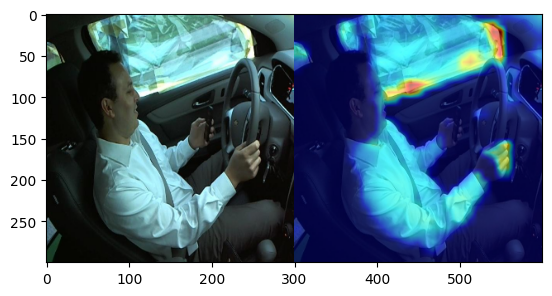

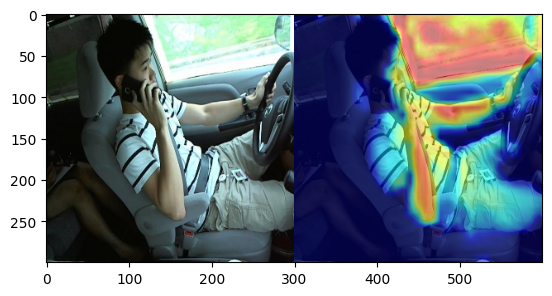

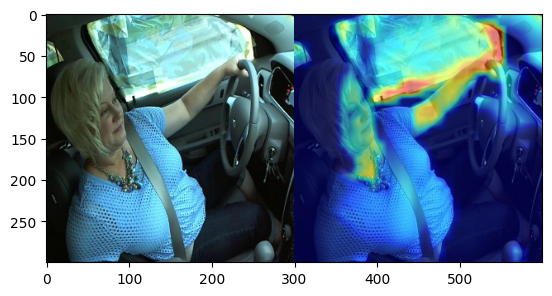

...

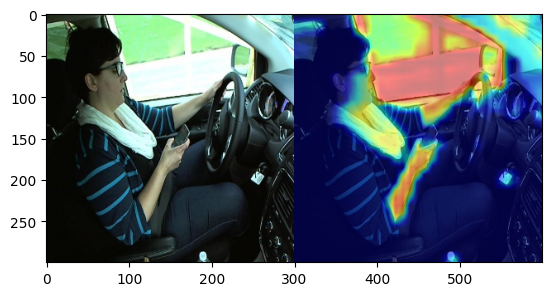

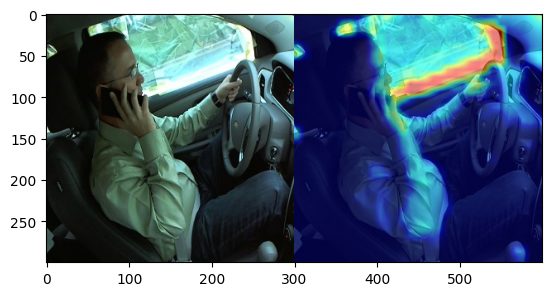

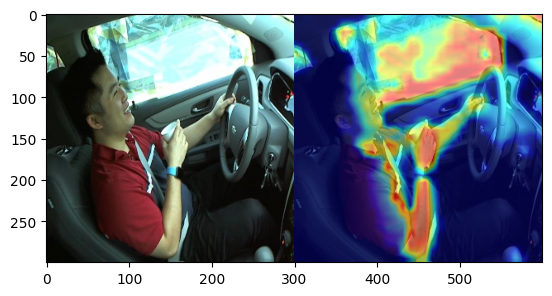

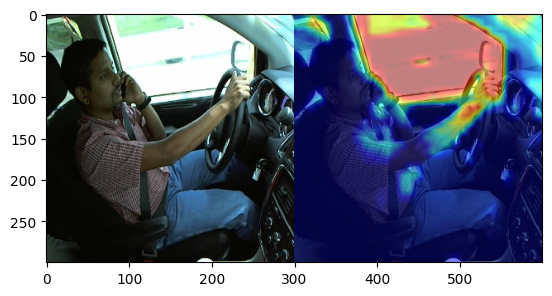

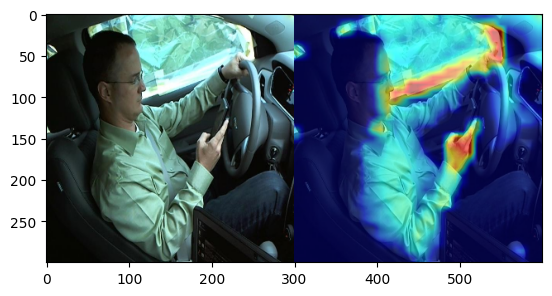

In [208]:
# Instantiate the GradCAM object
cam = GradCAM(model=model, target_layers=target_layers)

for tempImg in no_right_predicted_images[:30]:
    input_tensor = tempImg.unsqueeze(0)
    input_image = transform(tempImg)
    input_image = np.float32(input_image) / 255.0

    # Generate CAM
    grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
    cam_image = show_cam_on_image(input_image, grayscale_cams[0, :], use_rgb=True)

    cam_np = np.uint8(255 * grayscale_cams[0, :])
    cam_np = cv2.merge([cam_np, cam_np, cam_np])

    # Display the original image & the associated CAM
    images = np.hstack((np.uint8(255 * input_image), cam_image))
    plt.imshow(images)
    plt.show()